In [27]:
%load_ext autoreload
%autoreload 2

from tensorflow.keras.applications.densenet import DenseNet121
from matplotlib import pyplot as plt
from sklearn import cluster

import tensorflow as tf
import numpy as np
import sys, os

sys.path.insert(1, os.path.join(sys.path[0], ".."))
from reproduction.pipeline.load import load_data
from reproduction import analysis

In [2]:
ds = load_data(
    data_glob="../data/tif/*.tfrecord",
    shape=(128, 128, 7),
)

In [3]:
def sample(dataset, n=3000):
    names, coords, imgs = [], [], []
    batch = dataset.make_one_shot_iterator().get_next()
    with tf.Session() as sess:
        while len(imgs) < n:
            names_, coords_, imgs_ = sess.run(batch)
            names.extend(names_)
            coords.extend(coords_)
            imgs.extend(imgs_)
            
    names = np.array([str(n)[2:-1] for n in names[:n]])
    coords = np.stack(coords[:n])
    imgs = np.stack(imgs[:n])
    return names, coords, imgs

In [4]:
names, coords, imgs = sample(ds)

## 0-1 normalize clipping 95th percentile

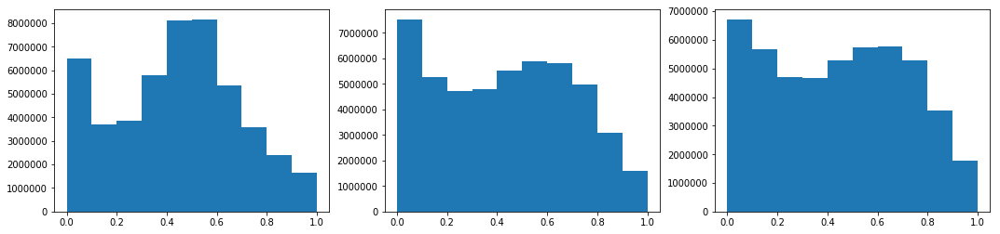

In [34]:
reds = [1, 4, 5, 6]
greens = [0]
blues = [2, 3]

ii = np.stack([imgs[:,:,:,col].mean(axis=3) for col in (reds, greens, blues)], axis=3)

colors = []
for col in (reds, greens, blues):
    ii = imgs[:, :, :, col].mean(axis=3)
    ii = np.clip(ii, *np.percentile(ii, [0, 99]))
    ii /= (ii.max() - ii.min())
    ii -= ii.min()
    colors.append(ii)

ii = np.stack(colors, axis=3)

fig, ax = plt.subplots(1,3, figsize=(18,4))

for c, a in enumerate(ax):
    a.hist(ii[:,:,:,c].ravel())

In [35]:
dn = DenseNet121(include_top=False)

In [36]:
features = dn.predict(ii).mean(axis=(1,2))

In [37]:
clu = cluster.SpectralClustering(40).fit(features[:, :100])

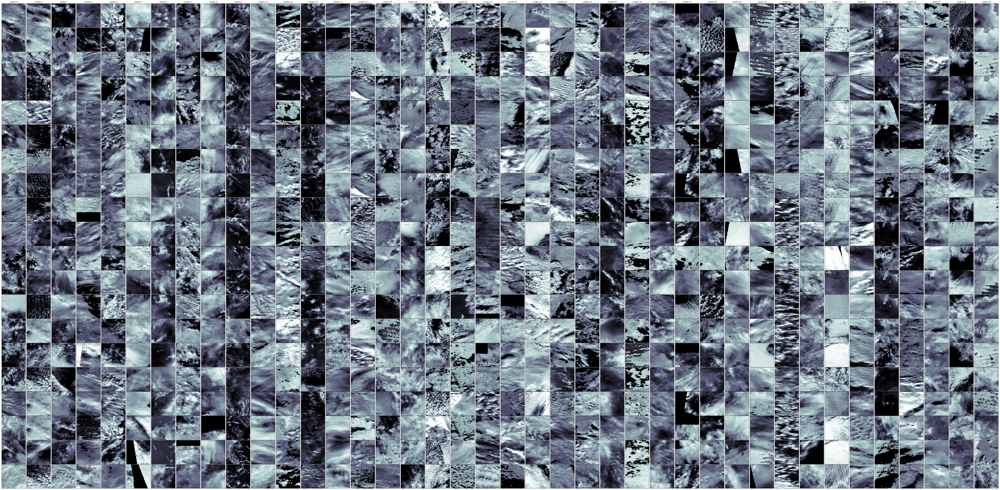

In [39]:
analysis.plot_cluster_samples(ii[:,:,:,0], clu.labels_, samples=20);